In [112]:
import numpy as np
import pandas as pd
import re

import umap.umap_ as umap 
import scipy.sparse

from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
#import gensim
#from gensim.utils import simple_preprocess
from nltk.stem import PorterStemmer

import chart_studio
import chart_studio.plotly as py
import plotly.express as px
import matplotlib.pyplot as plt
%matplotlib inline

In [83]:
username = 'leguela' # your username
api_key = 'dUoZ8GPRarmVDovaJE1F' # your api key - go to profile > settings > regenerate key
chart_studio.tools.set_credentials_file(username=username, api_key=api_key)

In [145]:
# open files
tweets_fr = pd.read_csv('../data/tweets_fr_translated.csv')
tweets_us_north = pd.read_csv('../data/tweets_us_north-clean.csv')
tweets_us_south = pd.read_csv('../data/tweets_us_south_clean.csv')

In [146]:
tweets_fr["country"] = 'France'
tweets_us_north["country"] = 'US NE'
tweets_us_south["country"] = 'US SE'

In [147]:
tweets_fr = (tweets_fr
             .drop(columns = ["text"])
             .rename(columns= {"translated_text": "text"})            
            )

In [171]:
tweets_all = pd.concat([tweets_fr, tweets_us_north, tweets_us_south], ignore_index=True)

In [172]:
tweets_all.head(1)

,id,date,location,follower_count,retweets,vaccine,text,country
0,1393495540940300288,2021-05-15 09:16:41,Bordeaux,1133,0,astrazeneca,"This is another pb. In any case, the limitatio...",France


In [173]:
tweets_all = tweets_all.dropna(subset=['vaccine'])

In [174]:
tweets_all.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 32946 entries, 0 to 33040
Data columns (total 8 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   id              32946 non-null  int64 
 1   date            32946 non-null  object
 2   location        32896 non-null  object
 3   follower_count  32946 non-null  int64 
 4   retweets        32946 non-null  int64 
 5   vaccine         32946 non-null  object
 6   text            32946 non-null  object
 7   country         32946 non-null  object
dtypes: int64(3), object(5)
memory usage: 2.3+ MB


In [175]:
vect = CountVectorizer(ngram_range=(1,1),
        analyzer='word',
        stop_words='english'
    )

tweets_vec = vect.fit_transform(tweets_all.text)

In [176]:
tweets_vec

<32946x28676 sparse matrix of type '<class 'numpy.int64'>'
	with 410573 stored elements in Compressed Sparse Row format>

In [183]:
reducer = umap.UMAP(init='random')

In [184]:
embedding = reducer.fit_transform(tweets_vec)

In [179]:
embedding.shape

(32946, 2)

In [185]:
umap_tweets = pd.DataFrame({'vaccine': tweets_all.vaccine ,'state': tweets_all.country, 'tweets': tweets_all.text, 'x': embedding[:,0], 'y': embedding[:,1]})

In [186]:
fig = px.scatter(data_frame = umap_tweets, x = 'x', y = 'y', color = 'state', hover_data = ['tweets'])
fig.show()

In [187]:
fig = px.scatter(data_frame = umap_tweets, x = 'x', y = 'y', color = 'vaccine', hover_data = ['tweets'])
fig.show()

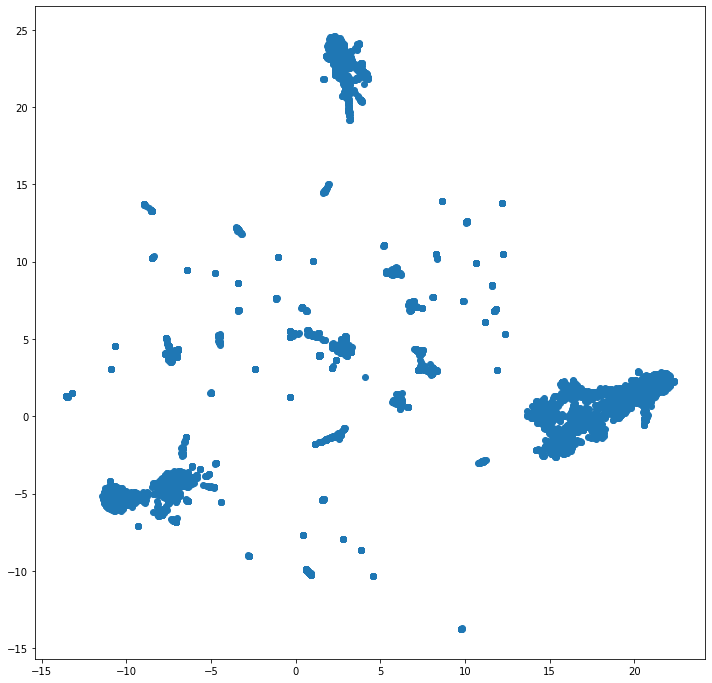

In [143]:
#fig = plt.figure(figsize=(12,12))
#plt.scatter(embedding[:,0], embedding[:,1]);